In [31]:
import pandas as pd  #for data manipulation operations
import numpy as np  #for numeric operations on data
import seaborn as sns  #for data visualization operations
import matplotlib.pyplot as plt  #for data visualization operations
from sklearn.preprocessing import LabelEncoder # for encoding
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler #for standardization

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import scipy.stats as st
from termcolor import colored

#from markupsafe import escape
#!pip install pandas-profiling
#import pandas_profiling

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score, roc_curve
# from sklearn.metrics import plot_confusion_matrix
from sklearn import model_selection
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
#!pip install lightgbm
# from lightgbm import LGBMClassifier

#ignore warnings
import warnings
warnings.filterwarnings("ignore")

#see model parametres
from sklearn import set_config
set_config(print_changed_only = False)

print(colored("\n THE REQUIRED LIBRARIES WERE SUCCESFULLY IMPORTED...", "red"))


 THE REQUIRED LIBRARIES WERE SUCCESFULLY IMPORTED...


In [32]:
%%time
data = pd.read_csv("C:\\Users\\iamim\OneDrive\\Desktop\\Imaad_Folder\\MLP\MLP_05\\archive\\data.csv")

CPU times: total: 0 ns
Wall time: 7.51 ms


In [33]:
data.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [34]:
data.memory_usage(deep=True)

Index                        132
id                          4552
diagnosis                  33002
radius_mean                 4552
texture_mean                4552
perimeter_mean              4552
area_mean                   4552
smoothness_mean             4552
compactness_mean            4552
concavity_mean              4552
concave points_mean         4552
symmetry_mean               4552
fractal_dimension_mean      4552
radius_se                   4552
texture_se                  4552
perimeter_se                4552
area_se                     4552
smoothness_se               4552
compactness_se              4552
concavity_se                4552
concave points_se           4552
symmetry_se                 4552
fractal_dimension_se        4552
radius_worst                4552
texture_worst               4552
perimeter_worst             4552
area_worst                  4552
smoothness_worst            4552
compactness_worst           4552
concavity_worst             4552
concave po

In [35]:
data.memory_usage(deep=True) * 1e-6

Index                      0.000132
id                         0.004552
diagnosis                  0.033002
radius_mean                0.004552
texture_mean               0.004552
perimeter_mean             0.004552
area_mean                  0.004552
smoothness_mean            0.004552
compactness_mean           0.004552
concavity_mean             0.004552
concave points_mean        0.004552
symmetry_mean              0.004552
fractal_dimension_mean     0.004552
radius_se                  0.004552
texture_se                 0.004552
perimeter_se               0.004552
area_se                    0.004552
smoothness_se              0.004552
compactness_se             0.004552
concavity_se               0.004552
concave points_se          0.004552
symmetry_se                0.004552
fractal_dimension_se       0.004552
radius_worst               0.004552
texture_worst              0.004552
perimeter_worst            0.004552
area_worst                 0.004552
smoothness_worst           0

In [36]:
#Data Cleaning
df=data.copy
df

<bound method NDFrame.copy of            id diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
0      842302         M        17.99         10.38          122.80     1001.0   
1      842517         M        20.57         17.77          132.90     1326.0   
2    84300903         M        19.69         21.25          130.00     1203.0   
3    84348301         M        11.42         20.38           77.58      386.1   
4    84358402         M        20.29         14.34          135.10     1297.0   
..        ...       ...          ...           ...             ...        ...   
564    926424         M        21.56         22.39          142.00     1479.0   
565    926682         M        20.13         28.25          131.20     1261.0   
566    926954         M        16.60         28.08          108.30      858.1   
567    927241         M        20.60         29.33          140.10     1265.0   
568     92751         B         7.76         24.54           47.92      181.0  

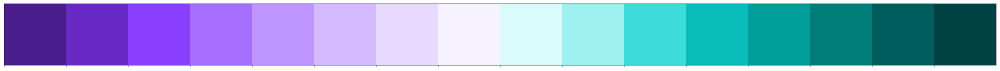

In [37]:
patterns=[
 '#491d8b'
 ,'#6929c4'
 ,'#8a3ffc'
 ,'#a56eff'
 ,'#be95ff'
 ,'#d4bbff'
 ,'#e8daff'
 ,'#f6f2ff'
 ,'#d9fbfb'
 ,'#9ef0f0'
 ,'#3ddbd9'
 ,'#08bdba'
 ,'#009d9a'
 ,'#007d79'
 ,'#005d5d'
, '#004144'
]
sns.palplot(patterns, size = 2)

In [38]:
df = data.copy()
df.head(n = 10).style.background_gradient(cmap = "Blues")

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.990000,10.380000,122.800000,1001.000000,0.118400,0.277600,0.300100,0.147100,0.241900,0.078710,1.095000,0.905300,8.589000,153.400000,0.006399,0.049040,0.053730,0.015870,0.030030,0.006193,25.380000,17.330000,184.600000,2019.000000,0.162200,0.665600,0.711900,0.265400,0.460100,0.118900
1,842517,M,20.570000,17.770000,132.900000,1326.000000,0.084740,0.078640,0.086900,0.070170,0.181200,0.056670,0.543500,0.733900,3.398000,74.080000,0.005225,0.013080,0.018600,0.013400,0.013890,0.003532,24.990000,23.410000,158.800000,1956.000000,0.123800,0.186600,0.241600,0.186000,0.275000,0.089020
2,84300903,M,19.690000,21.250000,130.000000,1203.000000,0.109600,0.159900,0.197400,0.127900,0.206900,0.059990,0.745600,0.786900,4.585000,94.030000,0.006150,0.040060,0.038320,0.020580,0.022500,0.004571,23.570000,25.530000,152.500000,1709.000000,0.144400,0.424500,0.450400,0.243000,0.361300,0.087580
3,84348301,M,11.420000,20.380000,77.580000,386.100000,0.142500,0.283900,0.241400,0.105200,0.259700,0.097440,0.495600,1.156000,3.445000,27.230000,0.009110,0.074580,0.056610,0.018670,0.059630,0.009208,14.910000,26.500000,98.870000,567.700000,0.209800,0.866300,0.686900,0.257500,0.663800,0.173000
4,84358402,M,20.290000,14.340000,135.100000,1297.000000,0.100300,0.132800,0.198000,0.104300,0.180900,0.058830,0.757200,0.781300,5.438000,94.440000,0.011490,0.024610,0.056880,0.018850,0.017560,0.005115,22.540000,16.670000,152.200000,1575.000000,0.137400,0.205000,0.400000,0.162500,0.236400,0.076780
5,843786,M,12.450000,15.700000,82.570000,477.100000,0.127800,0.170000,0.157800,0.080890,0.208700,0.076130,0.334500,0.890200,2.217000,27.190000,0.007510,0.033450,0.036720,0.011370,0.021650,0.005082,15.470000,23.750000,103.400000,741.600000,0.179100,0.524900,0.535500,0.174100,0.398500,0.124400
6,844359,M,18.250000,19.980000,119.600000,1040.000000,0.094630,0.109000,0.112700,0.074000,0.179400,0.057420,0.446700,0.773200,3.180000,53.910000,0.004314,0.013820,0.022540,0.010390,0.013690,0.002179,22.880000,27.660000,153.200000,1606.000000,0.144200,0.257600,0.378400,0.193200,0.306300,0.083680
7,84458202,M,13.710000,20.830000,90.200000,577.900000,0.118900,0.164500,0.093660,0.059850,0.219600,0.074510,0.583500,1.377000,3.856000,50.960000,0.008805,0.030290,0.024880,0.014480,0.014860,0.005412,17.060000,28.140000,110.600000,897.000000,0.165400,0.368200,0.267800,0.155600,0.319600,0.115100
8,844981,M,13.000000,21.820000,87.500000,519.800000,0.127300,0.193200,0.185900,0.093530,0.235000,0.073890,0.306300,1.002000,2.406000,24.320000,0.005731,0.035020,0.035530,0.012260,0.021430,0.003749,15.490000,30.730000,106.200000,739.300000,0.170300,0.540100,0.539000,0.206000,0.437800,0.107200
9,84501001,M,12.460000,24.040000,83.970000,475.900000,0.118600,0.239600,0.227300,0.085430,0.203000,0.082430,0.297600,1.599000,2.039000,23.940000,0.007149,0.072170,0.077430,0.014320,0.017890,0.010080,15.090000,40.680000,97.650000,711.400000,0.185300,1.058000,1.105000,0.221000,0.436600,0.207500


In [39]:
df.describe().T.style.background_gradient(cmap = "magma")

,count,mean,std,min,25%,50%,75%,max
id,569.000000,30371831.432337,125020585.612224,8670.000000,869218.000000,906024.000000,8813129.000000,911320502.000000
radius_mean,569.000000,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.110000
texture_mean,569.000000,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.280000
perimeter_mean,569.000000,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.500000
area_mean,569.000000,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.000000
smoothness_mean,569.000000,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.163400
compactness_mean,569.000000,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.345400
concavity_mean,569.000000,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.426800
concave points_mean,569.000000,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.201200
symmetry_mean,569.000000,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.304000


In [40]:
data.shape

(569, 32)

In [41]:
data.info

<bound method DataFrame.info of            id diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
0      842302         M        17.99         10.38          122.80     1001.0   
1      842517         M        20.57         17.77          132.90     1326.0   
2    84300903         M        19.69         21.25          130.00     1203.0   
3    84348301         M        11.42         20.38           77.58      386.1   
4    84358402         M        20.29         14.34          135.10     1297.0   
..        ...       ...          ...           ...             ...        ...   
564    926424         M        21.56         22.39          142.00     1479.0   
565    926682         M        20.13         28.25          131.20     1261.0   
566    926954         M        16.60         28.08          108.30      858.1   
567    927241         M        20.60         29.33          140.10     1265.0   
568     92751         B         7.76         24.54           47.92      181.0

In [42]:
data.isnull()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
565,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
566,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
567,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [43]:
data.isnull().any()

id                         False
diagnosis                  False
radius_mean                False
texture_mean               False
perimeter_mean             False
area_mean                  False
smoothness_mean            False
compactness_mean           False
concavity_mean             False
concave points_mean        False
symmetry_mean              False
fractal_dimension_mean     False
radius_se                  False
texture_se                 False
perimeter_se               False
area_se                    False
smoothness_se              False
compactness_se             False
concavity_se               False
concave points_se          False
symmetry_se                False
fractal_dimension_se       False
radius_worst               False
texture_worst              False
perimeter_worst            False
area_worst                 False
smoothness_worst           False
compactness_worst          False
concavity_worst            False
concave points_worst       False
symmetry_w

In [44]:
data.isnull().sum()

id                         0
diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [45]:
data.describe(include="O")

,diagnosis
count,569
unique,2
top,B
freq,357


In [46]:
data.diagnosis.value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

## Data Visualization

In [57]:
# 1. Pair Plot
sns.pairplot(df, hue='diagnosis', diag_kind='kde')
plt.title('Pair Plot')
plt.show()

# 2. Correlation Heatmap
corr_matrix = df.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# 3. Box Plot
plt.figure(figsize=(12, 8))
sns.boxplot(x='diagnosis', y='radius_mean', data=df)
plt.title('Box Plot of Radius Mean by Diagnosis')
plt.show()

# 4. Violin Plot
plt.figure(figsize=(12, 8))
sns.violinplot(x='diagnosis', y='texture_mean', data=df)
plt.title('Violin Plot of Texture Mean by Diagnosis')
plt.show()

# 5. Histogram
plt.figure(figsize=(12, 8))
sns.histplot(data=df, x='area_mean', hue='diagnosis', element='step', kde=True)
plt.title('Histogram of Area Mean by Diagnosis')
plt.show()


ValueError: could not convert string to float: 'M'

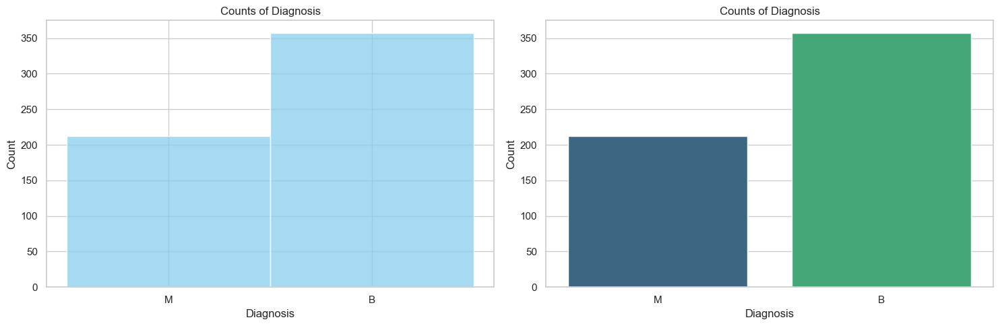

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for Seaborn
sns.set(style='whitegrid')

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Plot 1: Histogram
sns.histplot(data['diagnosis'], ax=axes[0], color='skyblue', bins=2, kde=False)
axes[0].set_title("Counts of Diagnosis")
axes[0].set_xlabel("Diagnosis")
axes[0].set_ylabel("Count")

# Plot 2: Countplot
sns.countplot(x='diagnosis', data=data, ax=axes[1], palette='viridis')
axes[1].set_title("Counts of Diagnosis")
axes[1].set_xlabel("Diagnosis")
axes[1].set_ylabel("Count")

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the plots
plt.show()


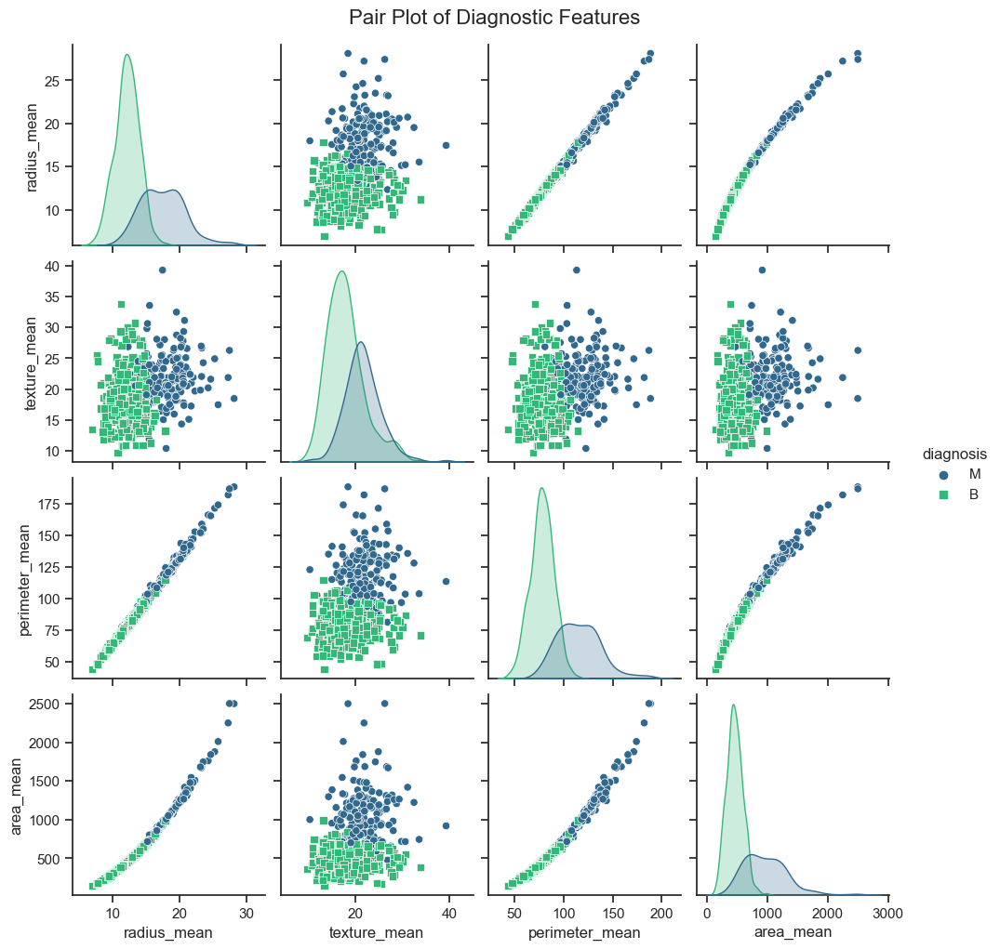

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the style for Seaborn
sns.set(style="ticks")

# Select columns for the pair plot
cols = ["diagnosis", "radius_mean", "texture_mean", "perimeter_mean", "area_mean"]

# Create a pair plot with hue based on 'diagnosis'
sns.pairplot(data[cols], hue="diagnosis", palette="viridis", markers=["o", "s"], diag_kind="kde")

# Customize plot titles
plt.suptitle("Pair Plot of Diagnostic Features", y=1.02, size=16)

# Show the plot
plt.show()


In [60]:
import plotly.express as px

# Create a scatter plot using plotly express
fig = px.scatter(data, x='texture_mean', y='radius_mean', size='area_mean', color='area_mean',
                 hover_name='diagnosis', opacity=0.7,
                 labels={'texture_mean': 'Texture Mean', 'radius_mean': 'Radius Mean'},
                 title='Scatter Plot of Texture Mean vs. Radius Mean',
                 size_max=30, color_continuous_scale='viridis')

# Add axis labels
fig.update_xaxes(title_text='Texture Mean', showgrid=True, gridwidth=1, gridcolor='LightGray')
fig.update_yaxes(title_text='Radius Mean', showgrid=True, gridwidth=1, gridcolor='LightGray')

# Show the plot
fig.show()


Conversion of Unique value to numerical value (0/1)

In [71]:
from sklearn.preprocessing import LabelEncoder


In [72]:
data.head(2)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,1,17.99,10.38,122.8,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.6,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.9,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.8,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902


In [73]:
labelencoder_Y = LabelEncoder()
data.diagnosis = labelencoder_Y.fit_transform(data.diagnosis)

In [74]:
data.head(2)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,1,17.99,10.38,122.8,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.6,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.9,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.8,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902


In [75]:
print(data.diagnosis.value_counts())
print("\n", data.diagnosis.value_counts().sum())

diagnosis
0    357
1    212
Name: count, dtype: int64

 569


In [76]:
cols = ['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean']
print(len(cols))
data[cols].corr()

11


,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean
diagnosis,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,0.330499,-0.012838
radius_mean,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631
texture_mean,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437
perimeter_mean,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477
area_mean,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110
smoothness_mean,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792
compactness_mean,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369
concavity_mean,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783
concave points_mean,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917
symmetry_mean,0.330499,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921


In [77]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import numpy as np

# Exclude non-numeric columns
numeric_df = df.select_dtypes(include=[np.number])

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=('Pearson Correlation', 'Spearman Correlation'))
colorscale = [[1.0, "rgb(165,0,38)"],
              [0.8888888888888888, "rgb(215,48,39)"],
              [0.7777777777777778, "rgb(244,109,67)"],
              [0.6666666666666666, "rgb(253,174,97)"],
              [0.5555555555555556, "rgb(254,224,144)"],
              [0.4444444444444444, "rgb(224,243,248)"],
              [0.3333333333333333, "rgb(171,217,233)"],
              [0.2222222222222222, "rgb(116,173,209)"],
              [0.1111111111111111, "rgb(69,117,180)"],
              [0.0, "rgb(49,54,149)"]]

# Calculate Pearson correlation
s_val = numeric_df.corr(method='pearson')
s_idx = s_val.index
s_col = s_val.columns
s_val = s_val.values
fig.add_trace(
    go.Heatmap(x=s_col, y=s_idx, z=s_val, name='pearson', showscale=False, xgap=0.7, ygap=0.7, colorscale=colorscale),
    row=1, col=1
)

# Calculate Spearman correlation
s_val = numeric_df.corr(method='spearman')
s_idx = s_val.index
s_col = s_val.columns
s_val = s_val.values
fig.add_trace(
    go.Heatmap(x=s_col, y=s_idx, z=s_val, showscale=False, xgap=0.7, ygap=0.7, colorscale=colorscale),
    row=2, col=1
)

fig.update_layout(
    hoverlabel=dict(
        bgcolor="white",
        font_size=16,
        font_family="Rockwell"
    )
)
fig.update_layout(height=800, width=1100, title_text="Numeric Correlations")
fig.show()


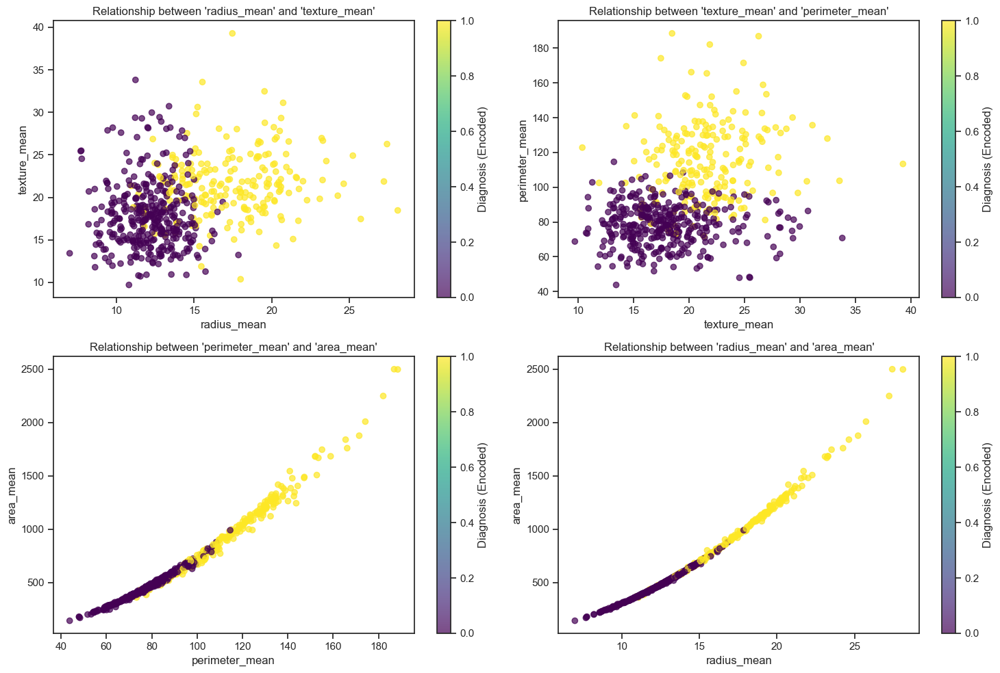

In [78]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Create a LabelEncoder instance
label_encoder = LabelEncoder()

# Encode the 'diagnosis' column
df['diagnosis_encoded'] = label_encoder.fit_transform(df['diagnosis'])

fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

# Scatter plot for 'radius_mean' and 'texture_mean'
scatter = axes[0].scatter(df['radius_mean'], df['texture_mean'], c=df['diagnosis_encoded'], cmap='viridis', alpha=0.7)
axes[0].set_title("Relationship between 'radius_mean' and 'texture_mean'")
axes[0].set_xlabel('radius_mean')
axes[0].set_ylabel('texture_mean')
fig.colorbar(scatter, ax=axes[0], label='Diagnosis (Encoded)')

# Scatter plot for 'texture_mean' and 'perimeter_mean'
scatter = axes[1].scatter(df['texture_mean'], df['perimeter_mean'], c=df['diagnosis_encoded'], cmap='viridis', alpha=0.7)
axes[1].set_title("Relationship between 'texture_mean' and 'perimeter_mean'")
axes[1].set_xlabel('texture_mean')
axes[1].set_ylabel('perimeter_mean')
fig.colorbar(scatter, ax=axes[1], label='Diagnosis (Encoded)')

# Scatter plot for 'perimeter_mean' and 'area_mean'
scatter = axes[2].scatter(df['perimeter_mean'], df['area_mean'], c=df['diagnosis_encoded'], cmap='viridis', alpha=0.7)
axes[2].set_title("Relationship between 'perimeter_mean' and 'area_mean'")
axes[2].set_xlabel('perimeter_mean')
axes[2].set_ylabel('area_mean')
fig.colorbar(scatter, ax=axes[2], label='Diagnosis (Encoded)')

# Scatter plot for 'radius_mean' and 'area_mean'
scatter = axes[3].scatter(df['radius_mean'], df['area_mean'], c=df['diagnosis_encoded'], cmap='viridis', alpha=0.7)
axes[3].set_title("Relationship between 'radius_mean' and 'area_mean'")
axes[3].set_xlabel('radius_mean')
axes[3].set_ylabel('area_mean')
fig.colorbar(scatter, ax=axes[3], label='Diagnosis (Encoded)')

plt.tight_layout()
plt.show()


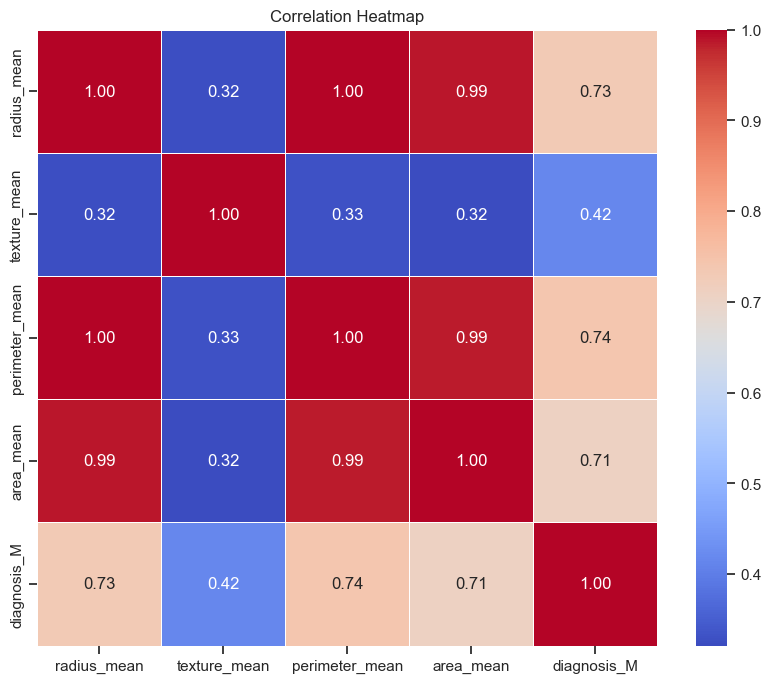

In [80]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select columns of interest
cols_of_interest = ["diagnosis", "radius_mean", "texture_mean", "perimeter_mean", "area_mean"]

# Create a subset dataframe with selected columns
subset_df = df[cols_of_interest]

# Encode the 'diagnosis' column for correlation analysis
subset_df = pd.get_dummies(subset_df, columns=['diagnosis'], drop_first=True)

# Calculate the correlation matrix
corr_matrix = subset_df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Heatmap")
plt.show()


In [81]:
plt.figure(figsize=(15, 10))


fig = px.imshow(data[cols].corr());
fig.show()

<Figure size 1500x1000 with 0 Axes>

In [85]:
import plotly.graph_objects as go
import pandas as pd

# Select columns of interest
cols_of_interest = ["radius_mean", "texture_mean", "area_mean"]

# Create a subset dataframe with selected columns
subset_df = df[cols_of_interest]

# Create a 3D surface plot
fig = go.Figure(data=[go.Surface(z=subset_df.values, x=subset_df.columns, y=subset_df.index)])

# Update layout
fig.update_layout(
    scene=dict(
        xaxis_title=subset_df.columns[0],
        yaxis_title=subset_df.columns[1],
        zaxis_title=subset_df.columns[2],
    ),
    autosize=True,
    width=800,
    height=800,
)

# Show the plot
fig.show()


## Model

In [82]:
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler

In [83]:
from sklearn.linear_model import LogisticRegression

from sklearn.tree import DecisionTreeClassifier

from sklearn.ensemble import RandomForestClassifier

from sklearn.naive_bayes import GaussianNB

from sklearn.neighbors import KNeighborsClassifier

In [84]:
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score

from sklearn.metrics import classification_report

from sklearn.model_selection import KFold

from sklearn.model_selection import cross_validate, cross_val_score

from sklearn.svm import SVC

from sklearn import metrics

In [86]:
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [87]:
prediction_feature = [ "radius_mean",  'perimeter_mean', 'area_mean', 'symmetry_mean', 'compactness_mean', 'concave points_mean']

targeted_feature = 'diagnosis'

len(prediction_feature)

6

In [89]:
X=data[prediction_feature]
X

,radius_mean,perimeter_mean,area_mean,symmetry_mean,compactness_mean,concave points_mean
0,17.99,122.80,1001.0,0.2419,0.27760,0.14710
1,20.57,132.90,1326.0,0.1812,0.07864,0.07017
2,19.69,130.00,1203.0,0.2069,0.15990,0.12790
3,11.42,77.58,386.1,0.2597,0.28390,0.10520
4,20.29,135.10,1297.0,0.1809,0.13280,0.10430
...,...,...,...,...,...,...
564,21.56,142.00,1479.0,0.1726,0.11590,0.13890
565,20.13,131.20,1261.0,0.1752,0.10340,0.09791
566,16.60,108.30,858.1,0.1590,0.10230,0.05302
567,20.60,140.10,1265.0,0.2397,0.27700,0.15200


In [91]:
y=data[targeted_feature]
y

0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int64

In [96]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=15)

print(X_train)


     radius_mean  perimeter_mean  area_mean  symmetry_mean  compactness_mean  \
274        17.93          115.20      998.9         0.1538           0.07027   
189        12.30           78.83      463.7         0.1667           0.07253   
158        12.06           76.84      448.6         0.1590           0.05241   
257        15.32          103.20      713.3         0.2398           0.22840   
486        14.64           94.21      666.0         0.1409           0.06698   
..           ...             ...        ...            ...               ...   
85         18.46          121.10     1075.0         0.2132           0.10530   
199        14.45           94.49      642.7         0.1950           0.12060   
156        17.68          117.40      963.7         0.1971           0.16650   
384        13.28           85.79      541.8         0.1617           0.08575   
456        11.63           74.87      415.1         0.1799           0.08574   

     concave points_mean  
274         

In [97]:
# Scale the data to keep all the values in the same magnitude of 0 -1 

sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.fit_transform(X_test)

### ML Model Selecting and Model PredPrediction


In [108]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def model_building(model, X_train, X_test, y_train, y_test):
    """
    Train a model, make predictions, and evaluate its performance.

    Parameters:
    - model: The machine learning model to be trained.
    - X_train: The training data features.
    - X_test: The testing data features.
    - y_train: The training data labels.
    - y_test: The testing data labels.

    Returns:
    - score: The model's score on the training set.
    - accuracy: The accuracy of the model on the test set.
    - predictions: The predicted labels on the test set.
    - precision: Precision of the model on the test set.
    - recall: Recall of the model on the test set.
    - f1: F1 score of the model on the test set.
    """
    
    # Train the model
    model.fit(X_train, y_train)
    
    # Get predicted probabilities if available
    if hasattr(model, 'predict_proba'):
        predicted_probs = model.predict_proba(X_test)[:, 1]
    else:
        predicted_probs = None

    # Make predictions
    predictions = model.predict(X_test)
    
    # Calculate evaluation metrics
    score = model.score(X_train, y_train)
    accuracy = accuracy_score(y_test, predictions)
    precision = precision_score(y_test, predictions)
    recall = recall_score(y_test, predictions)
    f1 = f1_score(y_test, predictions)
    
    return score, accuracy, predictions, predicted_probs, precision, recall, f1


In [109]:
models_list = {
    "LogisticRegression" :  LogisticRegression(),
    "RandomForestClassifier" :  RandomForestClassifier(n_estimators=10, criterion='entropy', random_state=5),
    "DecisionTreeClassifier" :  DecisionTreeClassifier(criterion='entropy', random_state=0),
    "SVC" :  SVC(),
}



In [110]:
print(list(models_list.keys()))
print(list(models_list.values()))

['LogisticRegression', 'RandomForestClassifier', 'DecisionTreeClassifier', 'SVC']
[LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False), RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='entropy', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=10, n_jobs=None, oob_score=False,
                       random_state=5, verbose=0, warm_start=False), DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
             

In [111]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_confusion_matrix(cm):
    """
    Plot a confusion matrix graph.

    Parameters:
    - cm: Confusion matrix (numpy array or DataFrame).

    Returns:
    Matplotlib Axes object.
    """
    try:
        ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.title('Confusion Matrix')
        plt.show()

        return ax

    except Exception as e:
        print(f"Error: {e}")


In [127]:
df_pred = pd.DataFrame(df_prediction, columns=df_prediction_cols)

In [129]:
# Create an empty list to store the results
results_list = []

# Loop through each model
for name, model in models_list.items():
    # Use the updated model_building function
    result = model_building(model, X_train, X_test, y_train, y_test)
    
    # Ensure that the result has at least three elements
    if len(result) >= 3:
        # Unpack the first three elements
        score, accuracy, predictions = result[:3]
    else:
        # Handle the case where there are not enough elements in the result
        print(f"Error: Not enough values returned by model_building for '{name}'. Skipping...")
        continue
    
    # Print classification report
    print(f"\n\nClassification Report of '{name}'\n")
    print(classification_report(y_test, predictions))
    
    # Calculate accuracy percentage
    accuracy_percentage = accuracy * 100
    
    # Append the results to the list
    results_list.append({
        'model_name': name,
        'score': score,
        'accuracy_score': accuracy,
        'accuracy_percentage': accuracy_percentage
    })

# Create a DataFrame from the list of results
df_predictions = pd.DataFrame(results_list)

# Display the DataFrame with predictions
df_predictions




Classification Report of 'LogisticRegression'

              precision    recall  f1-score   support

           0       0.90      0.96      0.93       115
           1       0.92      0.84      0.88        73

    accuracy                           0.91       188
   macro avg       0.91      0.90      0.90       188
weighted avg       0.91      0.91      0.91       188



Classification Report of 'RandomForestClassifier'

              precision    recall  f1-score   support

           0       0.92      0.96      0.94       115
           1       0.93      0.88      0.90        73

    accuracy                           0.93       188
   macro avg       0.93      0.92      0.92       188
weighted avg       0.93      0.93      0.93       188



Classification Report of 'DecisionTreeClassifier'

              precision    recall  f1-score   support

           0       0.90      0.96      0.93       115
           1       0.92      0.84      0.88        73

    accuracy               

,model_name,score,accuracy_score,accuracy_percentage
0,LogisticRegression,0.916010,0.909574,90.957447
1,RandomForestClassifier,0.992126,0.925532,92.553191
2,DecisionTreeClassifier,1.000000,0.909574,90.957447
3,SVC,0.923885,0.914894,91.489362


In [130]:
df_pred

,model_name,score,accuracy_score,accuracy_percentage


In [120]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 2))
# plt.title("Confusion Metric Graph")

for index, cm in enumerate(confusion_matrixs):
    # plt.xlabel("Negative Positive")
    # plt.ylabel("True Positive")

    # Show The Metrics Graph    
    cm_metrix_graph(cm)  # Assuming cm_metrix_graph is a function you've defined
    plt.tight_layout(pad=True)

plt.show()  # This should be outside the loop


<Figure size 1000x200 with 0 Axes>

In [132]:
# Sample For testing only

cv_score = cross_validate(LogisticRegression(), X, y, cv=3,
                        scoring=('r2', 'neg_mean_squared_error'),
                        return_train_score=True)

pd.DataFrame(cv_score).describe().T

,count,mean,std,min,25%,50%,75%,max
fit_time,3.0,0.015794,0.014077,0.006736,0.007685,0.008635,0.020324,0.032012
score_time,3.0,0.005090,0.004348,0.001559,0.002662,0.003764,0.006855,0.009946
test_r2,3.0,0.534312,0.186125,0.325364,0.460291,0.595218,0.638786,0.682353
train_r2,3.0,0.545196,0.051555,0.514363,0.515437,0.516511,0.560613,0.604714
test_neg_mean_squared_error,3.0,-0.108902,0.043669,-0.157895,-0.126316,-0.094737,-0.084405,-0.074074
train_neg_mean_squared_error,3.0,-0.106321,0.012102,-0.113456,-0.113307,-0.113158,-0.102753,-0.092348


In [134]:
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score

def cross_val_scoring(model, data, prediction_feature, targeted_feature):
    # Fit the model on the full dataset
    model.fit(data[prediction_feature], data[targeted_feature])
    
    # Evaluate accuracy on the full dataset
    predictions = model.predict(data[prediction_feature])
    accuracy = accuracy_score(predictions, data[targeted_feature])
    print("\nFull-Data Accuracy:", round(accuracy, 2))
    print("Cross-Validation Scores for", str(model), "\n")
    
    # Initialize K folds.
    kFold = KFold(n_splits=5)  # You can adjust the number of splits as needed
    
    # List to store cross-validation scores
    cv_scores = []
    
    for train_index, test_index in kFold.split(data):
        # Data Splitting via fold indexes
        X_train = data[prediction_feature].iloc[train_index, :]
        y_train = data[targeted_feature].iloc[train_index]
        
        X_test = data[prediction_feature].iloc[test_index, :]
        y_test = data[targeted_feature].iloc[test_index]
        
        # Fit the model on the training data
        model.fit(X_train, y_train)

        # Evaluate accuracy on the test fold
        fold_predictions = model.predict(X_test)
        fold_accuracy = accuracy_score(fold_predictions, y_test)
        
        # Append the fold accuracy to the list
        cv_scores.append(fold_accuracy)
        
        print("Cross-Validation Score (Fold):", round(fold_accuracy, 2))
    
    # Calculate and print the mean cross-validation score
    mean_cv_score = np.mean(cv_scores)
    print("\nMean Cross-Validation Score:", round(mean_cv_score, 2))



In [135]:
for name, model in zip(list(models_list.keys()), list(models_list.values())):
    cross_val_scorring(model)


Full-Data Accuracy: 0.9
Cross Validation Score of'LogisticRegression '

Score: 0.91
Score: 0.91
Score: 0.9
Score: 0.9
Score: 0.9

Full-Data Accuracy: 1.0
Cross Validation Score of'RandomForestClassifier '

Score: 0.99
Score: 0.99
Score: 0.99
Score: 1.0
Score: 1.0

Full-Data Accuracy: 1.0
Cross Validation Score of'DecisionTreeClassifier '

Score: 1.0
Score: 1.0
Score: 1.0
Score: 1.0
Score: 1.0

Full-Data Accuracy: 0.89
Cross Validation Score of'SVC '

Score: 0.9
Score: 0.89
Score: 0.88
Score: 0.88
Score: 0.88


### HyperTunning the ML Model

In [136]:
from  sklearn.model_selection import GridSearchCV


In [137]:
# Let's Implement Grid Search Algorithm

# Pick the model
model = DecisionTreeClassifier()

# Tunning Params
param_grid = {'max_features': ['auto', 'sqrt', 'log2'],
              'min_samples_split': [2,3,4,5,6,7,8,9,10], 
              'min_samples_leaf':[2,3,4,5,6,7,8,9,10] }


# Implement GridSearchCV
gsc = GridSearchCV(model, param_grid, cv=10) # For 10 Cross-Validation

gsc.fit(X_train, y_train) # Model Fitting

print("\n Best Score is ")
print(gsc.best_score_)

print("\n Best Estinator is ")
print(gsc.best_estimator_)

print("\n Best Parametes are")
print(gsc.best_params_)


 Best Score is 
0.9211201079622132

 Best Estinator is 
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features='log2', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=2,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=None, splitter='best')

 Best Parametes are
{'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 2}


### Observation
Using this Algorithm, we can see that

The best score is increases
know the best estimator parametes for final model
get the best parametes for it.

In [138]:
# Pick the model
model = KNeighborsClassifier()


# Tunning Params
param_grid = {
    'n_neighbors': list(range(1, 30)),
    'leaf_size': list(range(1,30)),
    'weights': [ 'distance', 'uniform' ]
}


# Implement GridSearchCV
gsc = GridSearchCV(model, param_grid, cv=10)

# Model Fitting
gsc.fit(X_train, y_train)

print("\n Best Score is ")
print(gsc.best_score_)

print("\n Best Estinator is ")
print(gsc.best_estimator_)

print("\n Best Parametes are")
print(gsc.best_params_)


 Best Score is 
0.9159244264507423

 Best Estinator is 
KNeighborsClassifier(algorithm='auto', leaf_size=1, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                     weights='uniform')

 Best Parametes are
{'leaf_size': 1, 'n_neighbors': 10, 'weights': 'uniform'}


### Observation
Using this Algorithm, we can see that

A little score improved compared to previous model
Showing the Best Estimator Parametes for final model
We can see the Best Parametes for KNN Model.

In [139]:
# Pick the model
model = SVC()


# Tunning Params
param_grid = [
              {'C': [1, 10, 100, 1000], 
               'kernel': ['linear']
              },
              {'C': [1, 10, 100, 1000], 
               'gamma': [0.001, 0.0001], 
               'kernel': ['rbf']
              }
]


# Implement GridSearchCV
gsc = GridSearchCV(model, param_grid, cv=10) # 10 Cross Validation

# Model Fitting
gsc.fit(X_train, y_train)

print("\n Best Score is ")
print(gsc.best_score_)

print("\n Best Estinator is ")
print(gsc.best_estimator_)

print("\n Best Parametes are")
print(gsc.best_params_)


 Best Score is 
0.9184885290148447

 Best Estinator is 
SVC(C=10, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.001, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

 Best Parametes are
{'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}


### Observation
Using this Algorithm, we can see that

It's gives slight better score
Showing the Best Estimator Parametes for final mode

In [140]:
# Pick the model
model = RandomForestClassifier()


# Tunning Params
random_grid = {'bootstrap': [True, False],
 'max_depth': [40, 50, None], # 10, 20, 30, 60, 70, 100,
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2], # , 4
 'min_samples_split': [2, 5], # , 10
 'n_estimators': [200, 400]} # , 600, 800, 1000, 1200, 1400, 1600, 1800, 2000

# Implement GridSearchCV
gsc = GridSearchCV(model, random_grid, cv=10) # 10 Cross Validation

# Model Fitting
gsc.fit(X_train, y_train)

print("\n Best Score is ")
print(gsc.best_score_)

print("\n Best Estinator is ")
print(gsc.best_estimator_)

print("\n Best Parametes are")
print(gsc.best_params_)


 Best Score is 
0.9105937921727396

 Best Estinator is 
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=40, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=2,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=200, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False)

 Best Parametes are
{'bootstrap': True, 'max_depth': 40, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}


### Observation
Using this Algorithm, we can see that

It's gives slight better score
Showing the Best Estimator Parametes for final model

### Deployment

In [143]:
import pickle as pkl

In [145]:
model.fit(X_train, y_train)
# save the model to disk
filename = 'finalized_model.sav'
pkl.dump(model, open(filename, 'wb'))
# load the model from disk
loaded_model = pkl.load(open(filename, 'rb'))
result = loaded_model.score(X_test, y_test)
print(result)

0.9095744680851063


In [146]:
# Trainned Model # You can also use your own trainned model
logistic_model = DecisionTreeClassifier()
logistic_model.fit(X_train, y_train)

filename = 'logistic_model.pkl'
pkl.dump(logistic_model, open(filename, 'wb')) # wb means write as binary

In [148]:
# load the model from disk
loaded_model = pkl.load(open(filename, 'rb')) # rb means read as binary
result = loaded_model.score(X_test, y_test)